
===== EXPERIMENT 1: IMAGE REPRESENTATION & COLOR SPACES =====

---- ANALYSIS OF: computer vision.jpg ----
Resolution         : 1920 x 1200
Number of channels : 3
File size          : 300.17 KB
Bit depth per channel : 8-bit


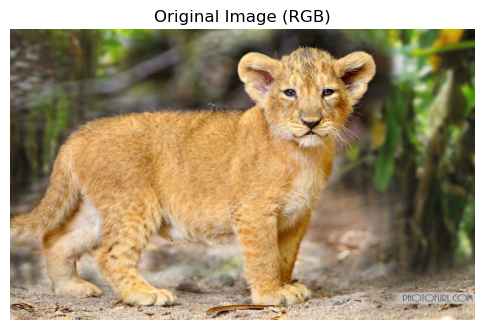


--> RGB → HSV Conversion
HSV channels extracted: H, S, V


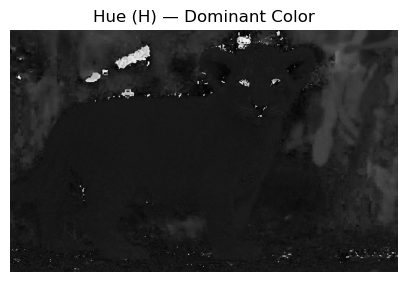

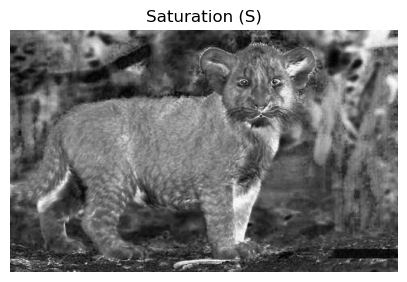

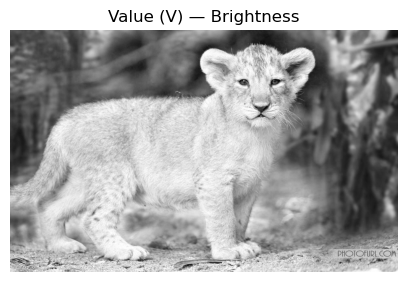


--> RGB → YCbCr Conversion


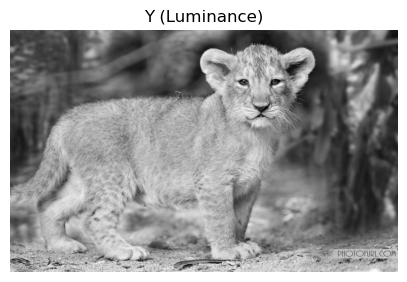

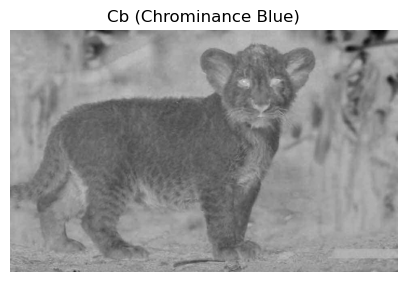

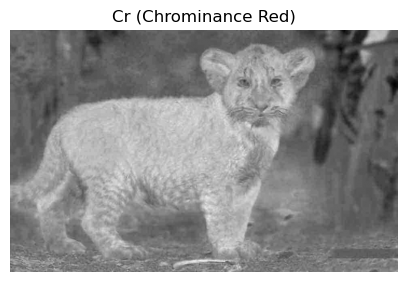


--> Splitting RGB Channels


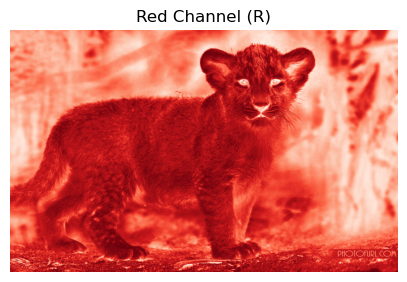

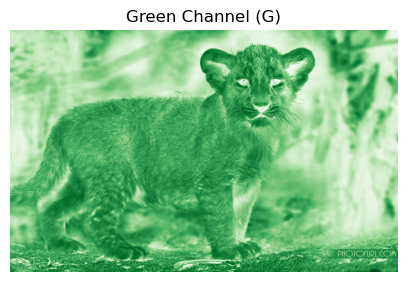

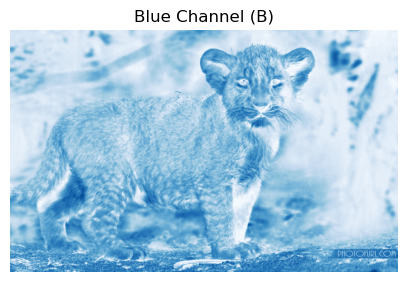


INTERPRETATION:
- H (Hue) shows the main color tone, independent of light.
- S (Saturation) shows color richness.
- V (Value) shows lighting/brightness.
- Y in YCbCr stores luminance → useful for compression & detection.
- Cb/Cr carry chrominance → smaller range, easier to encode.
- YCbCr separates brightness & color → used in JPEG, video coding.

===== END OF EXPERIMENT =====



In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# ------------------------ CONFIG ------------------------
IMAGE_PATHS = [
    r"C:\Users\Admin\Downloads\computer vision.jpg",

]
# --------------------------------------------------------

def show_channel(title, channel, cmap=None):
    """Utility function to display a channel using matplotlib."""
    plt.figure(figsize=(5, 4))
    plt.title(title)
    plt.imshow(channel, cmap=cmap)
    plt.axis("off")
    plt.show()


def analyze_image_properties(img_path, img):
    """Prints metadata for each image."""
    print(f"\n---- ANALYSIS OF: {os.path.basename(img_path)} ----")

    # Image shape
    h, w = img.shape[:2]
    channels = img.shape[2] if len(img.shape) == 3 else 1

    # File size
    file_size_kb = os.path.getsize(img_path) / 1024

    # Bit depth (approx)
    bit_depth = img.dtype.itemsize * 8

    print(f"Resolution         : {w} x {h}")
    print(f"Number of channels : {channels}")
    print(f"File size          : {file_size_kb:.2f} KB")
    print(f"Bit depth per channel : {bit_depth}-bit")


def run_experiment():
    print("\n===== EXPERIMENT 1: IMAGE REPRESENTATION & COLOR SPACES =====")

    for img_path in IMAGE_PATHS:
        img = cv2.imread(img_path)

        if img is None:
            print(f"❌ Could not load: {img_path}")
            continue

        # Convert BGR → RGB
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # ------------------------------------------------------------
        # PART 1: IMAGE REPRESENTATION
        # ------------------------------------------------------------
        analyze_image_properties(img_path, img)

        # Display original
        plt.figure(figsize=(6, 5))
        plt.title("Original Image (RGB)")
        plt.imshow(img_rgb)
        plt.axis("off")
        plt.show()

        # ------------------------------------------------------------
        # PART 2: COLOR SPACE CONVERSIONS
        # ------------------------------------------------------------

        print("\n--> RGB → HSV Conversion")
        hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(hsv)

        print("HSV channels extracted: H, S, V")

        show_channel("Hue (H) — Dominant Color", h, cmap="gray")
        show_channel("Saturation (S)", s, cmap="gray")
        show_channel("Value (V) — Brightness", v, cmap="gray")

        print("\n--> RGB → YCbCr Conversion")
        ycbcr = cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)
        y, cr, cb = cv2.split(ycbcr)

        show_channel("Y (Luminance)", y, cmap="gray")
        show_channel("Cb (Chrominance Blue)", cb, cmap="gray")
        show_channel("Cr (Chrominance Red)", cr, cmap="gray")

        # ------------------------------------------------------------
        # PART 3: RGB CHANNEL VISUALIZATION
        # ------------------------------------------------------------
        print("\n--> Splitting RGB Channels")

        r, g, b = cv2.split(img_rgb)

        show_channel("Red Channel (R)", r, cmap="Reds")
        show_channel("Green Channel (G)", g, cmap="Greens")
        show_channel("Blue Channel (B)", b, cmap="Blues")

        print("\nINTERPRETATION:")
        print("- H (Hue) shows the main color tone, independent of light.")
        print("- S (Saturation) shows color richness.")
        print("- V (Value) shows lighting/brightness.")
        print("- Y in YCbCr stores luminance → useful for compression & detection.")
        print("- Cb/Cr carry chrominance → smaller range, easier to encode.")
        print("- YCbCr separates brightness & color → used in JPEG, video coding.")

    print("\n===== END OF EXPERIMENT =====\n")


# ------------------------ EXECUTE ------------------------
if __name__ == "__main__":
    run_experiment()

# NOTE FOR LAB SUBMISSION:
# Replace plt.imshow() with cv2.imshow() if your faculty requires it.

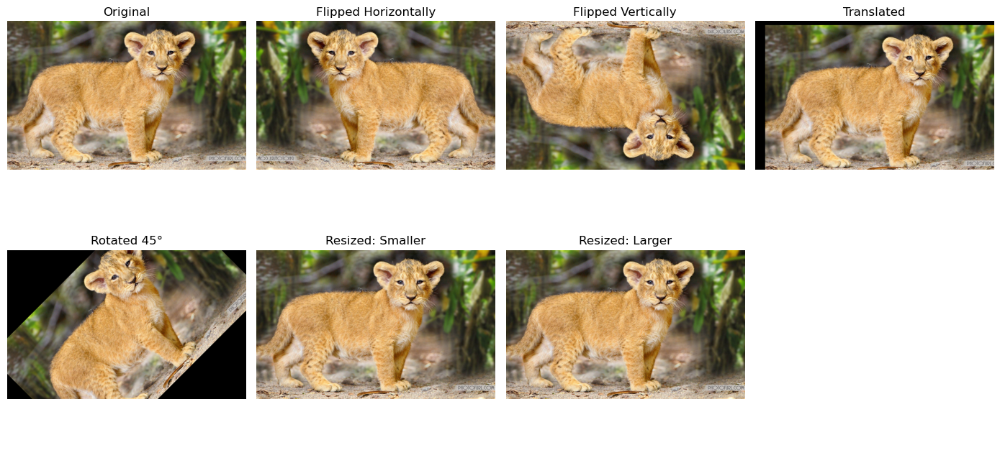

In [5]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# ------------------ Load Image ------------------
# Change this path to your image (gear / bottle-cap / lion, etc.)
IMG_PATH = r"C:\Users\Admin\Downloads\computer vision.jpg"

img_bgr = cv2.imread(IMG_PATH)
if img_bgr is None:
    raise FileNotFoundError(f"Image not found at: {IMG_PATH}")

# OpenCV uses BGR, matplotlib needs RGB
img = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
h, w = img.shape[:2]

# ------------------ 1. Translation ------------------
# shift right by 80 px, down by 40 px
tx, ty = 80, 40
M_trans = np.float32([[1, 0, tx],
                      [0, 1, ty]])

translated = cv2.warpAffine(img, M_trans, (w, h))

# ------------------ 2. Rotation (45°) ------------------
center = (w // 2, h // 2)
angle = 45
scale = 1.0

M_rot = cv2.getRotationMatrix2D(center, angle, scale)
rotated = cv2.warpAffine(img, M_rot, (w, h))

# ------------------ 3. Resizing ------------------
# Smaller (0.5x) and larger (1.5x) versions
smaller = cv2.resize(img, None, fx=0.5, fy=0.5, interpolation=cv2.INTER_AREA)
larger  = cv2.resize(img, None, fx=1.5, fy=1.5, interpolation=cv2.INTER_CUBIC)

# ------------------ 4. Flipping ------------------
flip_h = cv2.flip(img, 1)  # horizontal flip
flip_v = cv2.flip(img, 0)  # vertical flip

# ------------------ 5. Display with subplots ------------------
plt.figure(figsize=(14, 7))

plt.subplot(2, 4, 1)
plt.imshow(img)
plt.title("Original")
plt.axis("off")

plt.subplot(2, 4, 2)
plt.imshow(flip_h)
plt.title("Flipped Horizontally")
plt.axis("off")

plt.subplot(2, 4, 3)
plt.imshow(flip_v)
plt.title("Flipped Vertically")
plt.axis("off")

plt.subplot(2, 4, 4)
plt.imshow(translated)
plt.title("Translated")
plt.axis("off")

plt.subplot(2, 4, 5)
plt.imshow(rotated)
plt.title("Rotated 45°")
plt.axis("off")

plt.subplot(2, 4, 6)
plt.imshow(smaller)
plt.title("Resized: Smaller")
plt.axis("off")

plt.subplot(2, 4, 7)
plt.imshow(larger)
plt.title("Resized: Larger")
plt.axis("off")

plt.subplot(2, 4, 8)
plt.axis("off")  # empty slot

plt.tight_layout()
plt.show()


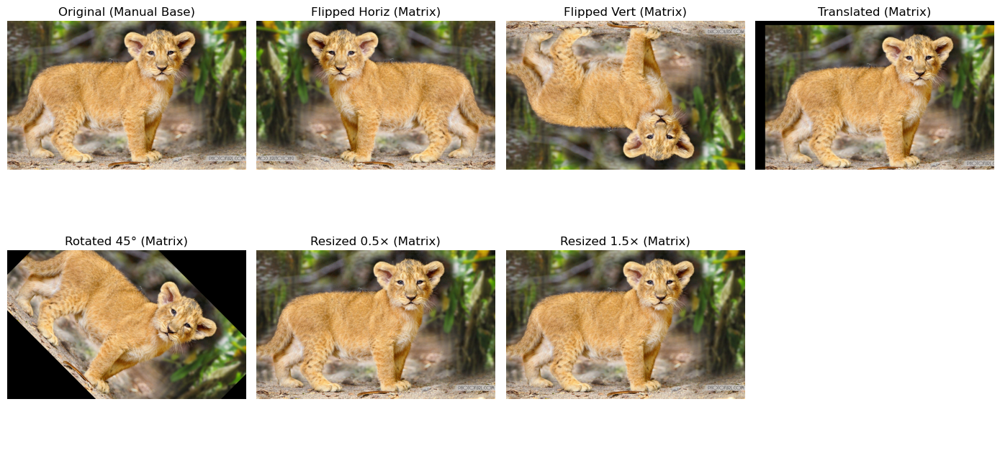

In [7]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# ------------------ Load Image ------------------
IMG_PATH = r"C:\Users\Admin\Downloads\computer vision.jpg"   # Change to your chosen image
img_bgr = cv2.imread(IMG_PATH)
if img_bgr is None:
    raise FileNotFoundError(f"Image not found at: {IMG_PATH}")

img = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
h, w = img.shape[:2]


# ============================================================
# Helper Function — Manual Affine Transform (Vectorized)
# ============================================================
def affine_transform_nn(image, M, out_size):
    """
    Applies a 2×3 affine matrix M using nearest-neighbor sampling.
    image: input image (RGB)
    M: 2×3 affine transform matrix
    out_size: (width, height) of output image
    """
    w_out, h_out = out_size
    h_in, w_in = image.shape[:2]

    # Convert 2×3 matrix to 3×3 and invert it
    M_full = np.vstack([M, [0, 0, 1]])
    M_inv = np.linalg.inv(M_full)

    # Create full grid for output image
    xs, ys = np.meshgrid(np.arange(w_out), np.arange(h_out))
    ones = np.ones_like(xs)

    dest = np.stack([xs, ys, ones], axis=-1).reshape(-1, 3).T
    src = M_inv @ dest

    # Nearest neighbor sampling
    sx = np.rint(src[0]).astype(int)
    sy = np.rint(src[1]).astype(int)

    # Mask valid points
    valid = (sx >= 0) & (sx < w_in) & (sy >= 0) & (sy < h_in)

    out = np.zeros((h_out, w_out, 3), dtype=image.dtype)
    out_flat = out.reshape(-1, 3)

    src_idx = sy * w_in + sx
    dst_idx = np.arange(h_out * w_out)

    out_flat[dst_idx[valid]] = image.reshape(-1, 3)[src_idx[valid]]
    return out


# ============================================================
# 1. TRANSLATION
# ============================================================
tx, ty = 80, 40
M_trans = np.array([[1, 0, tx],
                    [0, 1, ty]], dtype=np.float32)

translated = affine_transform_nn(img, M_trans, out_size=(w, h))


# ============================================================
# 2. ROTATION BY 45° AROUND IMAGE CENTER
# ============================================================
theta = np.deg2rad(45)
cos_a, sin_a = np.cos(theta), np.sin(theta)
cx, cy = w / 2, h / 2

T1 = np.array([[1, 0, -cx],
               [0, 1, -cy],
               [0, 0, 1]], dtype=np.float32)

R = np.array([[cos_a, -sin_a, 0],
              [sin_a,  cos_a, 0],
              [0,      0,     1]], dtype=np.float32)

T2 = np.array([[1, 0, cx],
               [0, 1, cy],
               [0, 0, 1]], dtype=np.float32)

M_rot_full = T2 @ R @ T1         # 3×3
M_rot = M_rot_full[:2, :]        # 2×3 for affine
rotated = affine_transform_nn(img, M_rot, out_size=(w, h))


# ============================================================
# 3. RESIZING USING SCALING MATRIX
# ============================================================
scale_small = 0.5
scale_large = 1.5

# Smaller
M_small = np.array([[scale_small, 0, 0],
                    [0, scale_small, 0]], dtype=np.float32)

small_w = int(w * scale_small)
small_h = int(h * scale_small)

smaller = affine_transform_nn(img, M_small, out_size=(small_w, small_h))

# Larger
M_large = np.array([[scale_large, 0, 0],
                    [0, scale_large, 0]], dtype=np.float32)

large_w = int(w * scale_large)
large_h = int(h * scale_large)

larger = affine_transform_nn(img, M_large, out_size=(large_w, large_h))


# ============================================================
# 4. FLIPPING USING MATRICES
# ============================================================
# Horizontal flip: x' = -x + (w-1)
M_flip_h = np.array([[-1, 0, w - 1],
                     [ 0, 1, 0     ]], dtype=np.float32)
flip_h = affine_transform_nn(img, M_flip_h, out_size=(w, h))

# Vertical flip: y' = -y + (h-1)
M_flip_v = np.array([[ 1, 0, 0     ],
                     [ 0,-1, h - 1]], dtype=np.float32)
flip_v = affine_transform_nn(img, M_flip_v, out_size=(w, h))


# ============================================================
# 5. DISPLAY RESULTS (Same 2×4 Layout as Part A)
# ============================================================
plt.figure(figsize=(14, 7))

plt.subplot(2, 4, 1)
plt.imshow(img)
plt.title("Original (Manual Base)")
plt.axis("off")

plt.subplot(2, 4, 2)
plt.imshow(flip_h)
plt.title("Flipped Horiz (Matrix)")
plt.axis("off")

plt.subplot(2, 4, 3)
plt.imshow(flip_v)
plt.title("Flipped Vert (Matrix)")
plt.axis("off")

plt.subplot(2, 4, 4)
plt.imshow(translated)
plt.title("Translated (Matrix)")
plt.axis("off")

plt.subplot(2, 4, 5)
plt.imshow(rotated)
plt.title("Rotated 45° (Matrix)")
plt.axis("off")

plt.subplot(2, 4, 6)
plt.imshow(smaller)
plt.title("Resized 0.5× (Matrix)")
plt.axis("off")

plt.subplot(2, 4, 7)
plt.imshow(larger)
plt.title("Resized 1.5× (Matrix)")
plt.axis("off")

plt.subplot(2, 4, 8)
plt.axis("off")   # optional empty slot

plt.tight_layout()
plt.show()



Processing image: C:\Users\Admin\OneDrive\Pictures\Screenshots 1\Screenshot 2025-12-05 112704.png


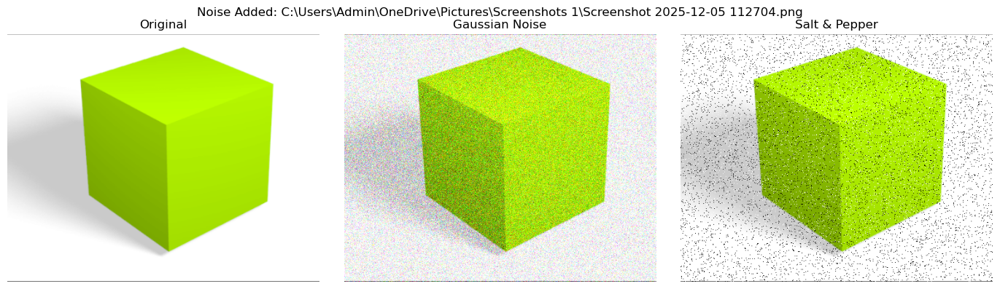

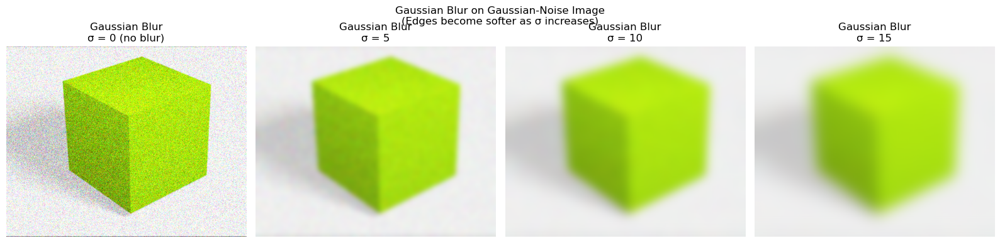

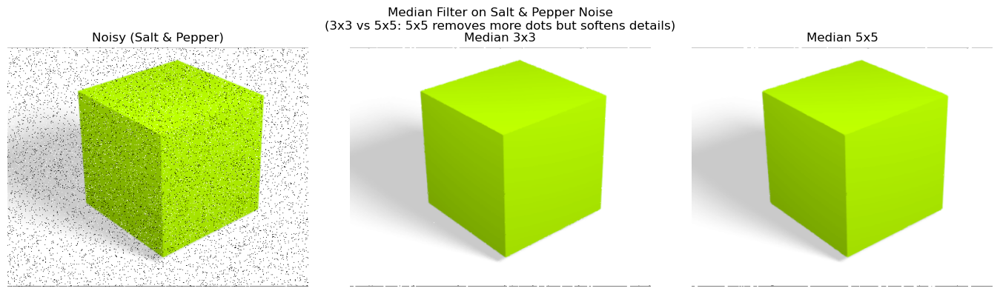

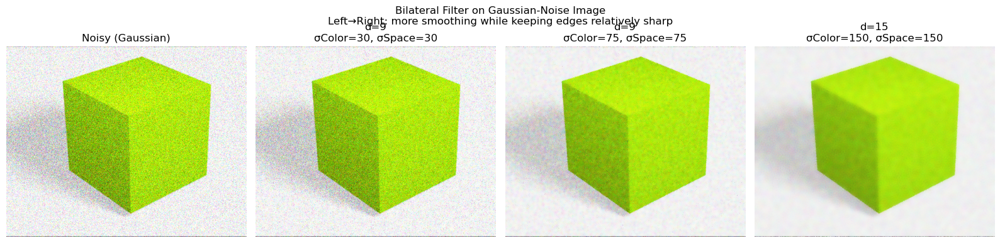

Fill your report table like this (example guidance):
Filter Type      Noise Type        Edges?                 Noise Removed?         Notes
Gaussian Blur    Gaussian          Blurred at high σ      Good at σ=10,15       Good for natural scenes, but edges lost.
Gaussian Blur    Salt & Pepper     Dots still visible     Not very effective    Not good for impulse noise.
Median Filter    Salt & Pepper     Edges ok (3x3)         Very good             5x5 removes more dots but softens thin lines.
Bilateral Filter Gaussian          Edges preserved        Good denoising        Best when you want smooth regions + sharp edges.
---------------------------------------------------------------------------------------

Processing image: C:\Users\Admin\OneDrive\Pictures\Screenshots 1\Screenshot 2025-12-05 112509.png


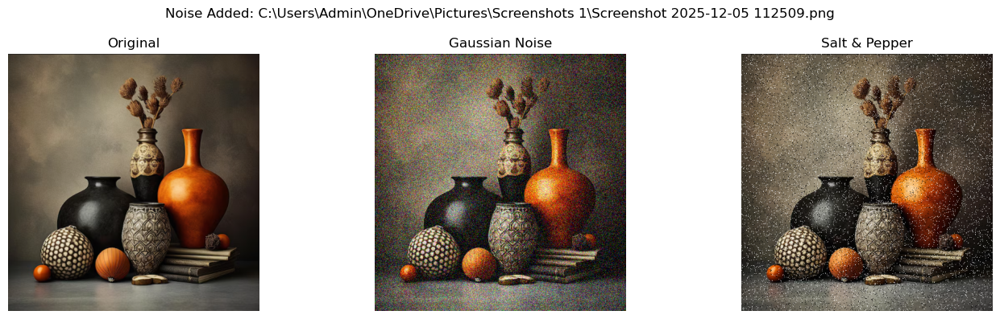

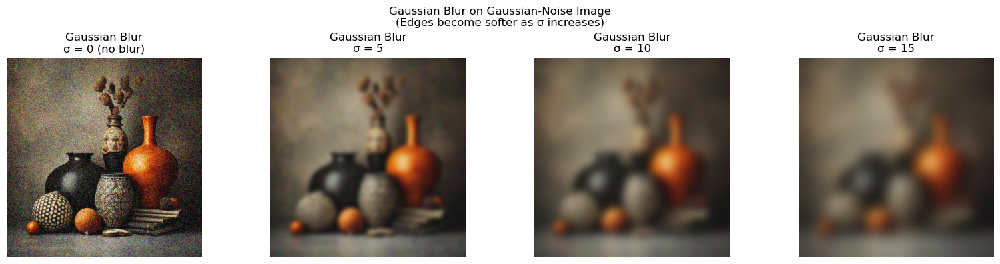

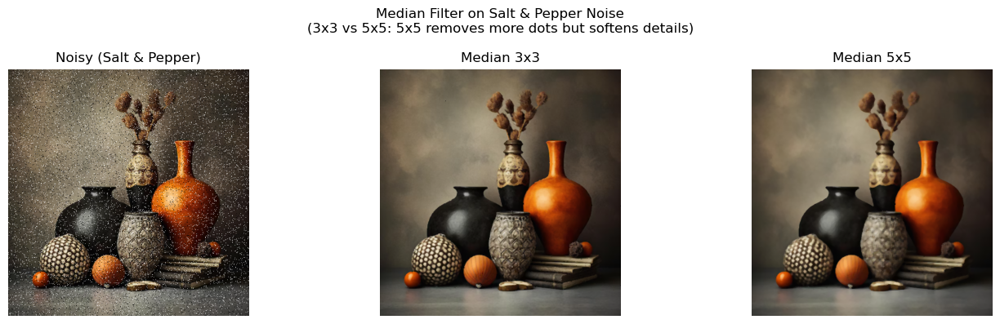

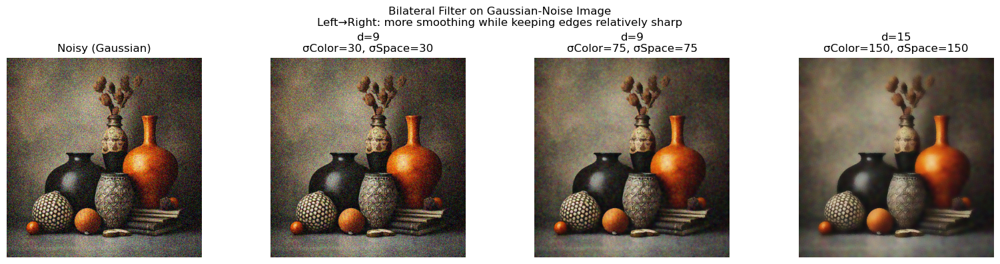

Fill your report table like this (example guidance):
Filter Type      Noise Type        Edges?                 Noise Removed?         Notes
Gaussian Blur    Gaussian          Blurred at high σ      Good at σ=10,15       Good for natural scenes, but edges lost.
Gaussian Blur    Salt & Pepper     Dots still visible     Not very effective    Not good for impulse noise.
Median Filter    Salt & Pepper     Edges ok (3x3)         Very good             5x5 removes more dots but softens thin lines.
Bilateral Filter Gaussian          Edges preserved        Good denoising        Best when you want smooth regions + sharp edges.
---------------------------------------------------------------------------------------

Processing image: C:\Users\Admin\Downloads\image 5.jpg


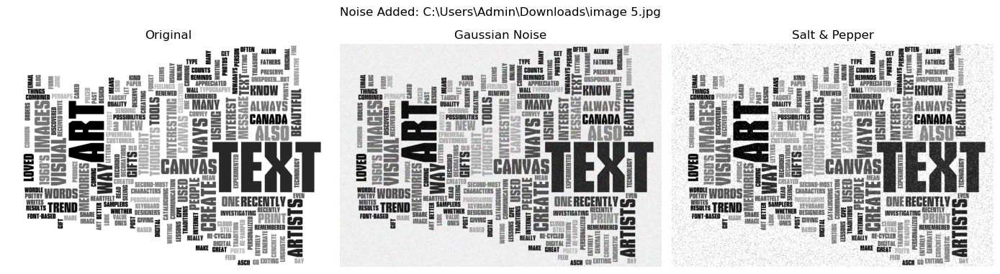

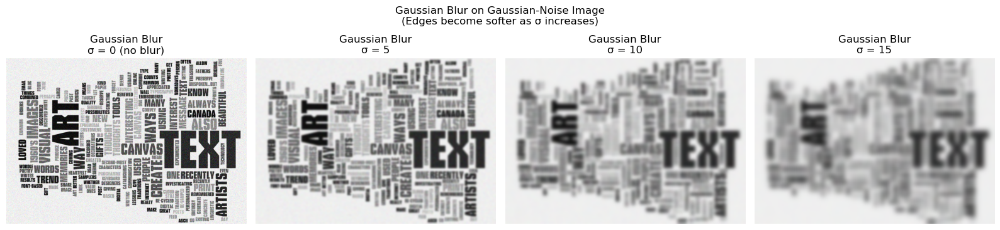

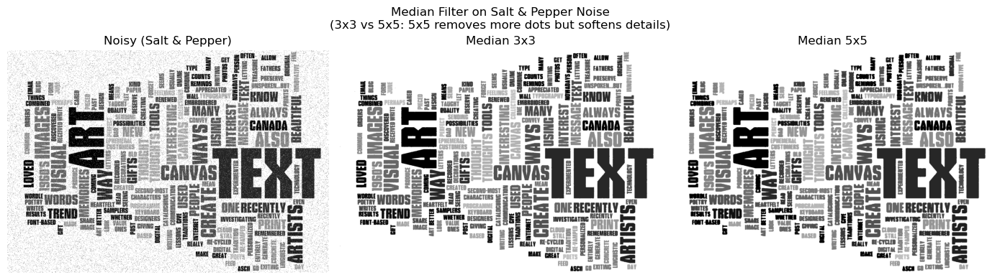

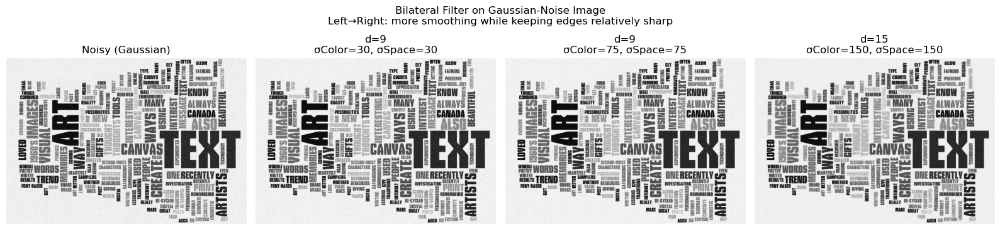

Fill your report table like this (example guidance):
Filter Type      Noise Type        Edges?                 Noise Removed?         Notes
Gaussian Blur    Gaussian          Blurred at high σ      Good at σ=10,15       Good for natural scenes, but edges lost.
Gaussian Blur    Salt & Pepper     Dots still visible     Not very effective    Not good for impulse noise.
Median Filter    Salt & Pepper     Edges ok (3x3)         Very good             5x5 removes more dots but softens thin lines.
Bilateral Filter Gaussian          Edges preserved        Good denoising        Best when you want smooth regions + sharp edges.
---------------------------------------------------------------------------------------

Processing image: C:\Users\Admin\Downloads\image 4.jpeg


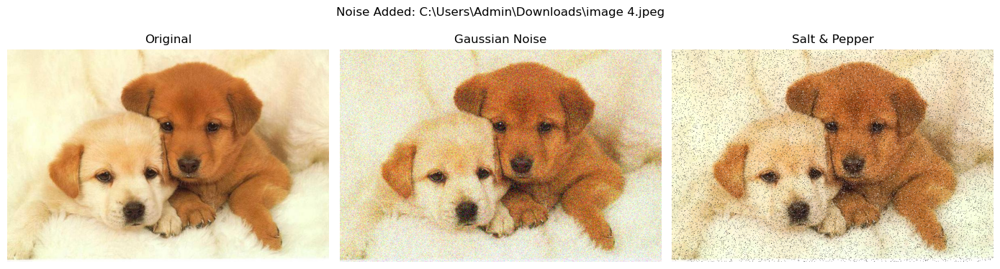

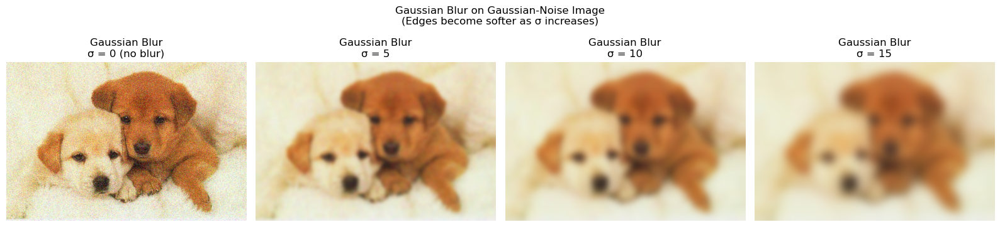

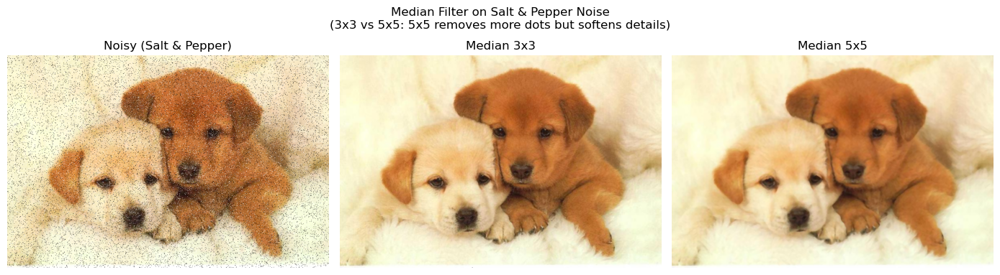

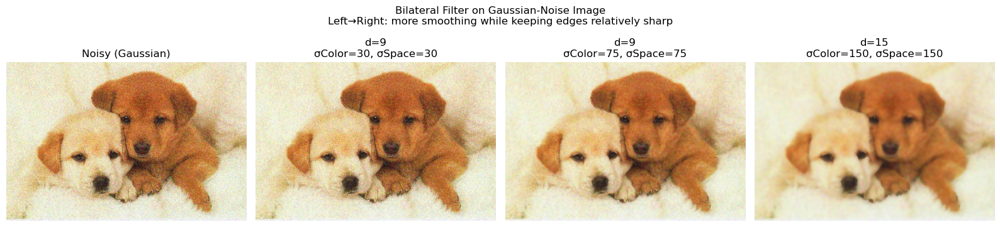

Fill your report table like this (example guidance):
Filter Type      Noise Type        Edges?                 Noise Removed?         Notes
Gaussian Blur    Gaussian          Blurred at high σ      Good at σ=10,15       Good for natural scenes, but edges lost.
Gaussian Blur    Salt & Pepper     Dots still visible     Not very effective    Not good for impulse noise.
Median Filter    Salt & Pepper     Edges ok (3x3)         Very good             5x5 removes more dots but softens thin lines.
Bilateral Filter Gaussian          Edges preserved        Good denoising        Best when you want smooth regions + sharp edges.
---------------------------------------------------------------------------------------


In [11]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# =========================================
# 1. IMAGE PATHS  (CHANGE THESE)
# =========================================
IMAGE_PATHS = [
    r"C:\Users\Admin\OneDrive\Pictures\Screenshots 1\Screenshot 2025-12-05 112704.png",      
    r"C:\Users\Admin\OneDrive\Pictures\Screenshots 1\Screenshot 2025-12-05 112509.png",     
    r"C:\Users\Admin\Downloads\image 5.jpg",     
    r"C:\Users\Admin\Downloads\image 4.jpeg",      
]

# =========================================
# 2. NOISE FUNCTIONS (STRONG ENOUGH TO SEE)
# =========================================
def add_gaussian_noise(img, mean=0, std=40):
    """
    Strong Gaussian noise so it is clearly visible.
    std = 40 gives noticeable camera grain.
    """
    noise = np.random.normal(mean, std, img.shape).astype(np.float32)
    noisy = img.astype(np.float32) + noise
    noisy = np.clip(noisy, 0, 255).astype(np.uint8)
    return noisy


def add_salt_pepper_noise(img, amount=0.08, s_vs_p=0.5):
    """
    Strong salt & pepper noise: 8% of pixels corrupted.
    Looks like white and black dots sprinkled on the image.
    """
    noisy = img.copy()
    h, w = img.shape[:2]
    num_pix = int(amount * h * w)

    # Salt (white)
    num_salt = int(num_pix * s_vs_p)
    ys = np.random.randint(0, h, num_salt)
    xs = np.random.randint(0, w, num_salt)
    noisy[ys, xs] = 255

    # Pepper (black)
    num_pepper = num_pix - num_salt
    ys = np.random.randint(0, h, num_pepper)
    xs = np.random.randint(0, w, num_pepper)
    noisy[ys, xs] = 0

    return noisy


# =========================================
# 3. FILTER PARAMETER SETTINGS
#    (STRONG ENOUGH EFFECTS)
# =========================================
# From the slide: σ = 5, 10, 15
gaussian_sigmas = [0, 5, 10, 15]

# From the slide: kernel sizes 3×3 and 5×5
median_ksizes   = [3, 5]

# Bilateral with increasing smoothing
bilateral_params = [
    (9,  30,  30),    # light
    (9,  75,  75),    # medium
    (15, 150, 150),   # heavy but edges still visible
]


# =========================================
# 4. MAIN LOOP
# =========================================
for path in IMAGE_PATHS:
    bgr = cv2.imread(path)
    if bgr is None:
        print(f"[WARNING] Could not load: {path} (skipping)")
        continue

    img = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)

    print("\n========================================")
    print(f"Processing image: {path}")
    print("========================================")

    # ---------- 4.1 ADD NOISE ----------
    noisy_gauss = add_gaussian_noise(img)          # strong Gaussian noise
    noisy_sp    = add_salt_pepper_noise(img)       # strong salt & pepper

    # Show Original + Noises
    plt.figure(figsize=(14, 4))
    plt.subplot(1, 3, 1); plt.imshow(img);         plt.title("Original");       plt.axis("off")
    plt.subplot(1, 3, 2); plt.imshow(noisy_gauss); plt.title("Gaussian Noise"); plt.axis("off")
    plt.subplot(1, 3, 3); plt.imshow(noisy_sp);    plt.title("Salt & Pepper");  plt.axis("off")
    plt.suptitle(f"Noise Added: {path}")
    plt.tight_layout()
    plt.show()

    # ---------- 4.2 GAUSSIAN BLUR ON GAUSSIAN-NOISY IMAGE ----------
    plt.figure(figsize=(16, 4))
    for i, sigma in enumerate(gaussian_sigmas):
        if sigma == 0:
            blurred = noisy_gauss.copy()
            label = "σ = 0 (no blur)"
        else:
            # (0,0) lets OpenCV pick kernel size based on sigma
            blurred = cv2.GaussianBlur(noisy_gauss, (0, 0), sigmaX=sigma)
            label = f"σ = {sigma}"

        plt.subplot(1, len(gaussian_sigmas), i + 1)
        plt.imshow(blurred)
        plt.title(f"Gaussian Blur\n{label}")
        plt.axis("off")

    plt.suptitle("Gaussian Blur on Gaussian-Noise Image\n(Edges become softer as σ increases)")
    plt.tight_layout()
    plt.show()

    # ---------- 4.3 MEDIAN FILTER ON SALT & PEPPER NOISE ----------
    plt.figure(figsize=(14, 4))
    plt.subplot(1, len(median_ksizes) + 1, 1)
    plt.imshow(noisy_sp); plt.title("Noisy (Salt & Pepper)"); plt.axis("off")

    for i, k in enumerate(median_ksizes):
        filtered = cv2.medianBlur(noisy_sp, k)
        plt.subplot(1, len(median_ksizes) + 1, i + 2)
        plt.imshow(filtered)
        plt.title(f"Median {k}x{k}")
        plt.axis("off")

    plt.suptitle("Median Filter on Salt & Pepper Noise\n(3x3 vs 5x5: 5x5 removes more dots but softens details)")
    plt.tight_layout()
    plt.show()

    # ---------- 4.4 BILATERAL FILTER ON GAUSSIAN-NOISY IMAGE ----------
    plt.figure(figsize=(16, 4))
    plt.subplot(1, len(bilateral_params) + 1, 1)
    plt.imshow(noisy_gauss); plt.title("Noisy (Gaussian)"); plt.axis("off")

    for i, (d, sc, ss) in enumerate(bilateral_params):
        filtered = cv2.bilateralFilter(noisy_gauss, d, sc, ss)
        plt.subplot(1, len(bilateral_params) + 1, i + 2)
        plt.imshow(filtered)
        plt.title(f"d={d}\nσColor={sc}, σSpace={ss}")
        plt.axis("off")

    plt.suptitle(
        "Bilateral Filter on Gaussian-Noise Image\n"
        "Left→Right: more smoothing while keeping edges relatively sharp"
    )
    plt.tight_layout()
    plt.show()

    # ---------- 4.5 TEXT SUMMARY FOR YOUR TABLE ----------
    print("Fill your report table like this (example guidance):")
    print("Filter Type      Noise Type        Edges?                 Noise Removed?         Notes")
    print("Gaussian Blur    Gaussian          Blurred at high σ      Good at σ=10,15       Good for natural scenes, but edges lost.")
    print("Gaussian Blur    Salt & Pepper     Dots still visible     Not very effective    Not good for impulse noise.")
    print("Median Filter    Salt & Pepper     Edges ok (3x3)         Very good             5x5 removes more dots but softens thin lines.")
    print("Bilateral Filter Gaussian          Edges preserved        Good denoising        Best when you want smooth regions + sharp edges.")
    print("---------------------------------------------------------------------------------------")


In [3]:
pip install numpy opencv-python matplotlib scikit-image



Processing image: C:\Users\Admin\OneDrive\Pictures\Screenshots 1\Screenshot 2025-12-05 112704.png


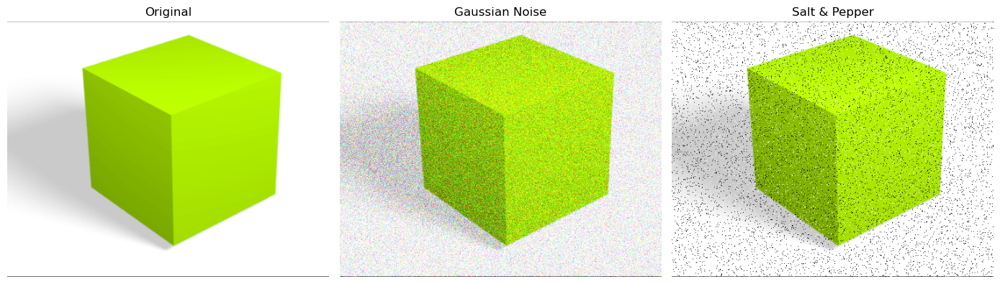


Fill your report table like this (auto-filled for this image):
Filter Type      Noise Type        Edges?                 Noise Removed?         Notes
Gaussian_no_blur  gaussian        Edges lost / weakened  Not very effective PSNR=18.09, SSIM=0.180
Gaussian_blur_σ5  gaussian        Edges lost / weakened  Good               Good for natural scenes; edges blur at high σ. Strong noise reduction but edges softened.
Gaussian_blur_σ10 gaussian        Edges lost / weakened  Good               Good for natural scenes; edges blur at high σ. Strong noise reduction but edges softened.
Gaussian_blur_σ15 gaussian        Edges lost / weakened  Good               Good for natural scenes; edges blur at high σ. Strong noise reduction but edges softened.
Median_3x3        salt_pepper     Edges preserved        Good               Removes impulse noise well; may soften thin lines.
Median_5x5        salt_pepper     Edges preserved        Good               Removes impulse noise well; may soften thin lines

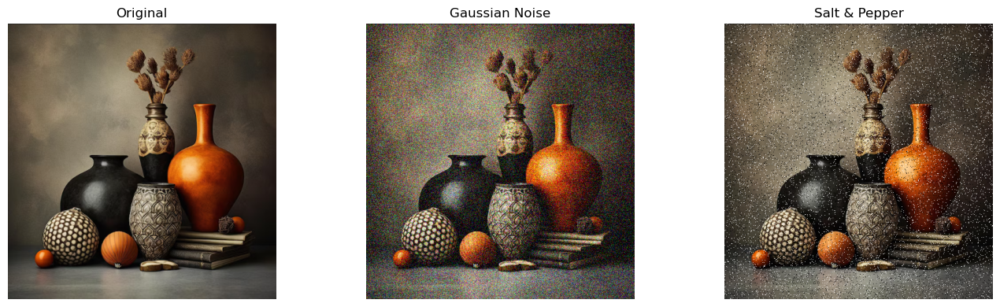


Fill your report table like this (auto-filled for this image):
Filter Type      Noise Type        Edges?                 Noise Removed?         Notes
Gaussian_no_blur  gaussian        Edges lost / weakened  Not very effective PSNR=16.79, SSIM=0.260
Gaussian_blur_σ5  gaussian        Edges lost / weakened  Good               Good for natural scenes; edges blur at high σ. Strong noise reduction but edges softened.
Gaussian_blur_σ10 gaussian        Edges lost / weakened  Good               Good for natural scenes; edges blur at high σ. Strong noise reduction but edges softened.
Gaussian_blur_σ15 gaussian        Edges lost / weakened  Good               Good for natural scenes; edges blur at high σ. Strong noise reduction but edges softened.
Median_3x3        salt_pepper     Edges preserved        Good               Removes impulse noise well; may soften thin lines.
Median_5x5        salt_pepper     Edges preserved        Good               Removes impulse noise well; may soften thin lines

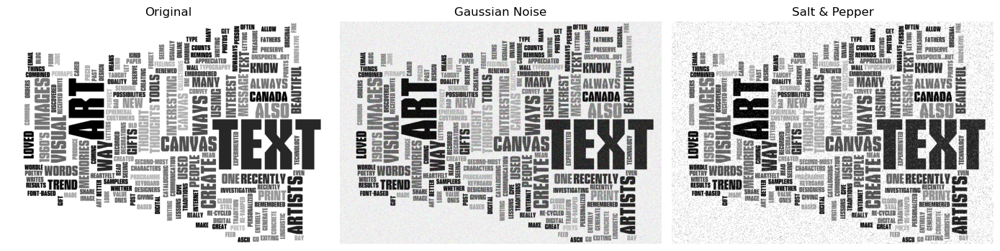


Fill your report table like this (auto-filled for this image):
Filter Type      Noise Type        Edges?                 Noise Removed?         Notes
Gaussian_no_blur  gaussian        Edges preserved        Not very effective PSNR=18.03, SSIM=0.494
Gaussian_blur_σ5  gaussian        Edges lost / weakened  Moderate           Good for natural scenes; edges blur at high σ.
Gaussian_blur_σ10 gaussian        Edges lost / weakened  Not very effective Good for natural scenes; edges blur at high σ.
Gaussian_blur_σ15 gaussian        Edges lost / weakened  Not very effective Good for natural scenes; edges blur at high σ.
Median_3x3        salt_pepper     Edges preserved        Good               Removes impulse noise well; may soften thin lines.
Median_5x5        salt_pepper     Edges preserved        Good               Removes impulse noise well; may soften thin lines.
Bilateral_d9_c30_s30 gaussian        Edges preserved        Good               Smooths while preserving edges; good balance.
Bi

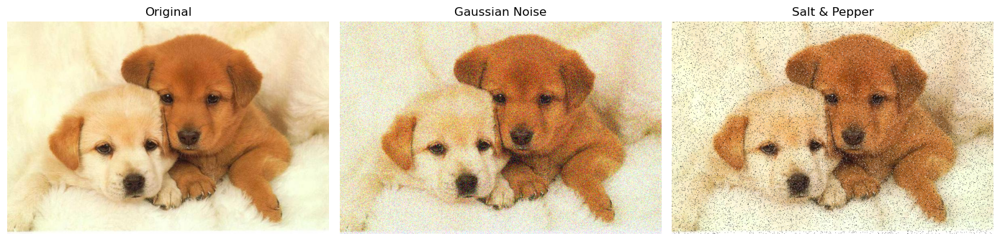


Fill your report table like this (auto-filled for this image):
Filter Type      Noise Type        Edges?                 Noise Removed?         Notes
Gaussian_no_blur  gaussian        Edges lost / weakened  Not very effective PSNR=17.25, SSIM=0.212
Gaussian_blur_σ5  gaussian        Edges lost / weakened  Good               Good for natural scenes; edges blur at high σ. Strong noise reduction but edges softened.
Gaussian_blur_σ10 gaussian        Edges lost / weakened  Good               Good for natural scenes; edges blur at high σ. Strong noise reduction but edges softened.
Gaussian_blur_σ15 gaussian        Edges lost / weakened  Good               Good for natural scenes; edges blur at high σ. Strong noise reduction but edges softened.
Median_3x3        salt_pepper     Edges preserved        Good               Removes impulse noise well; may soften thin lines.
Median_5x5        salt_pepper     Edges somewhat preserved Good               Removes impulse noise well; may soften thin lin

In [6]:
import os
import glob
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio as sk_psnr
from skimage.metrics import structural_similarity as sk_ssim
from datetime import datetime
import pandas as pd
from docx import Document
from docx.shared import Inches
from PIL import Image

# ==================================================
# USER: either list images explicitly OR set a folder
# ==================================================
IMAGE_FOLDER = r""  # <-- put folder path here to load ALL images from that folder (preferred)
IMAGE_PATHS = [
    r"C:\Users\Admin\OneDrive\Pictures\Screenshots 1\Screenshot 2025-12-05 112704.png",
    r"C:\Users\Admin\OneDrive\Pictures\Screenshots 1\Screenshot 2025-12-05 112509.png",
    r"C:\Users\Admin\Downloads\image 5.jpg",
    r"C:\Users\Admin\Downloads\image 4.jpeg",
]
# ==================================================

OUT_ROOT = "analysis_results"   # output directory for saved images + docx
SAVE_DOC = True                 # save Word report
THUMB_MAX_WIDTH_INCH = 3       # thumbnail width in Word doc

# Noise and filters
GAUSS_STD = 40
SP_AMOUNT = 0.08
SP_SALT_VS_PEPPER = 0.5
gaussian_sigmas = [0, 5, 10, 15]
median_ksizes = [3, 5]
bilateral_params = [(9,30,30),(9,75,75),(15,150,150)]

# thresholds
EDGE_F1_GOOD = 0.45
EDGE_F1_MED  = 0.25
PSNR_GAIN_GOOD = 1.5
PSNR_GAIN_MED  = 0.5
SSIM_GAIN_GOOD = 0.02
SSIM_GAIN_MED  = 0.005

# ----------------- helpers -----------------
def ensure_dir(d):
    os.makedirs(d, exist_ok=True)

def safe_name(path):
    name = os.path.splitext(os.path.basename(path))[0]
    return "".join(c if c.isalnum() or c in "-_." else "_" for c in name)

def add_gaussian_noise(img, mean=0, std=GAUSS_STD):
    noise = np.random.normal(mean, std, img.shape).astype(np.float32)
    noisy = img.astype(np.float32) + noise
    noisy = np.clip(noisy, 0, 255).astype(np.uint8)
    return noisy

def add_salt_pepper_noise(img, amount=SP_AMOUNT, s_vs_p=SP_SALT_VS_PEPPER):
    noisy = img.copy()
    h, w = img.shape[:2]
    num_pix = int(amount * h * w)
    ys = np.random.randint(0, h, int(num_pix * s_vs_p))
    xs = np.random.randint(0, w, int(num_pix * s_vs_p))
    noisy[ys, xs] = 255
    ys = np.random.randint(0, h, num_pix - int(num_pix * s_vs_p))
    xs = np.random.randint(0, w, num_pix - int(num_pix * s_vs_p))
    noisy[ys, xs] = 0
    return noisy

def psnr(a,b):
    return float(sk_psnr(a,b, data_range=255))

def ssim(a,b):
    a_gray = cv2.cvtColor(a, cv2.COLOR_RGB2GRAY)
    b_gray = cv2.cvtColor(b, cv2.COLOR_RGB2GRAY)
    return float(sk_ssim(a_gray, b_gray, data_range=255))

def edge_f1(orig, filt, canny_thresh=(100,200)):
    o = cv2.cvtColor(orig, cv2.COLOR_RGB2GRAY)
    f = cv2.cvtColor(filt, cv2.COLOR_RGB2GRAY)
    e_o = cv2.Canny(o, canny_thresh[0], canny_thresh[1]) > 0
    e_f = cv2.Canny(f, canny_thresh[0], canny_thresh[1]) > 0
    tp = np.logical_and(e_o, e_f).sum()
    fp = np.logical_and(~e_o, e_f).sum()
    fn = np.logical_and(e_o, ~e_f).sum()
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0.0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0.0
    f1 = (2 * precision * recall) / (precision + recall) if (precision + recall) > 0 else 0.0
    return f1

def qualitative_edge_text(f1):
    if f1 >= EDGE_F1_GOOD: return "Edges preserved"
    if f1 >= EDGE_F1_MED: return "Edges somewhat preserved"
    return "Edges lost / weakened"

def qualitative_noise_removed_text(psnr_gain, ssim_gain):
    if (psnr_gain >= PSNR_GAIN_GOOD) or (ssim_gain >= SSIM_GAIN_GOOD): return "Good"
    if (psnr_gain >= PSNR_GAIN_MED) or (ssim_gain >= SSIM_GAIN_MED): return "Moderate"
    return "Not very effective"

def save_rgb(img_rgb, path):
    # img_rgb in RGB uint8
    bgr = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2BGR)
    cv2.imwrite(path, bgr)

# ----------------- Word helpers -----------------
def add_image_to_doc(doc, img_path, width_inch=2.5):
    try:
        doc.add_picture(img_path, width=Inches(width_inch))
    except Exception:
        # fallback: open with PIL, convert to RGB, save as PNG and try again
        im = Image.open(img_path).convert("RGB")
        tmp = img_path + ".png"
        im.save(tmp, "PNG")
        doc.add_picture(tmp, width=Inches(width_inch))
        try:
            os.remove(tmp)
        except Exception:
            pass

# ----------------- main -----------------
# optionally read all images from folder
if IMAGE_FOLDER:
    exts = ("*.png","*.jpg","*.jpeg","*.bmp","*.tif","*.tiff")
    IMAGE_PATHS = []
    for e in exts:
        IMAGE_PATHS.extend(sorted(glob.glob(os.path.join(IMAGE_FOLDER, e))))

if not IMAGE_PATHS:
    print("No images found. Set IMAGE_FOLDER or populate IMAGE_PATHS.")
    raise SystemExit

ensure_dir(OUT_ROOT)

for path in IMAGE_PATHS:
    bgr = cv2.imread(path)
    if bgr is None:
        print(f"[WARNING] Could not load: {path} (skipping)")
        continue

    img = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
    name = safe_name(path)
    out_dir = os.path.join(OUT_ROOT, name)
    ensure_dir(out_dir)

    print("\n========================================")
    print(f"Processing image: {path}")
    print("========================================")

    # add noises
    noisy_gauss = add_gaussian_noise(img)
    noisy_sp = add_salt_pepper_noise(img)

    # save original + noisy images
    save_rgb(img, os.path.join(out_dir, f"{name}_original.png"))
    save_rgb(noisy_gauss, os.path.join(out_dir, f"{name}_noisy_gaussian.png"))
    save_rgb(noisy_sp, os.path.join(out_dir, f"{name}_noisy_sp.png"))

    # display (keeps existing plotting behavior)
    plt.figure(figsize=(14,4))
    plt.subplot(1,3,1); plt.imshow(img); plt.title("Original"); plt.axis('off')
    plt.subplot(1,3,2); plt.imshow(noisy_gauss); plt.title("Gaussian Noise"); plt.axis('off')
    plt.subplot(1,3,3); plt.imshow(noisy_sp); plt.title("Salt & Pepper"); plt.axis('off')
    plt.tight_layout(); plt.show()

    # compute baselines
    baseline_g_psnr = psnr(img, noisy_gauss)
    baseline_g_ssim = ssim(img, noisy_gauss)
    baseline_sp_psnr = psnr(img, noisy_sp)
    baseline_sp_ssim = ssim(img, noisy_sp)

    results = []  # rows for DataFrame + table

    # Gaussian blur family
    for sigma in gaussian_sigmas:
        if sigma == 0:
            filtered = noisy_gauss.copy()
            label = "Gaussian_no_blur"
        else:
            filtered = cv2.GaussianBlur(noisy_gauss, (0,0), sigmaX=sigma)
            label = f"Gaussian_blur_σ{sigma}"
        # save filtered
        save_rgb(filtered, os.path.join(out_dir, f"{name}_{label}.png"))
        p = psnr(img, filtered); s = ssim(img, filtered); e = edge_f1(img, filtered)
        results.append({
            "Filter Type": label,
            "Noise Type": "gaussian",
            "PSNR": p,
            "SSIM": s,
            "EdgeF1": e,
            "PSNR_gain": p - baseline_g_psnr,
            "SSIM_gain": s - baseline_g_ssim,
        })

    # Median on salt & pepper
    for k in median_ksizes:
        filtered = cv2.medianBlur(noisy_sp, k)
        label = f"Median_{k}x{k}"
        save_rgb(filtered, os.path.join(out_dir, f"{name}_{label}.png"))
        p = psnr(img, filtered); s = ssim(img, filtered); e = edge_f1(img, filtered)
        results.append({
            "Filter Type": label,
            "Noise Type": "salt_pepper",
            "PSNR": p,
            "SSIM": s,
            "EdgeF1": e,
            "PSNR_gain": p - baseline_sp_psnr,
            "SSIM_gain": s - baseline_sp_ssim,
        })

    # Bilateral on gaussian
    for (d, sc, ss) in bilateral_params:
        filtered = cv2.bilateralFilter(noisy_gauss, d, sc, ss)
        label = f"Bilateral_d{d}_c{sc}_s{ss}"
        save_rgb(filtered, os.path.join(out_dir, f"{name}_{label}.png"))
        p = psnr(img, filtered); s = ssim(img, filtered); e = edge_f1(img, filtered)
        results.append({
            "Filter Type": label,
            "Noise Type": "gaussian",
            "PSNR": p,
            "SSIM": s,
            "EdgeF1": e,
            "PSNR_gain": p - baseline_g_psnr,
            "SSIM_gain": s - baseline_g_ssim,
        })

    # Build DataFrame with qualitative columns
    rows_for_df = []
    for r in results:
        edge_txt = qualitative_edge_text(r["EdgeF1"])
        noise_txt = qualitative_noise_removed_text(r["PSNR_gain"], r["SSIM_gain"])
        # notes heuristics
        notes = []
        if r["Noise Type"] == "salt_pepper" and r["Filter Type"].startswith("Median"):
            notes.append("Removes impulse noise well; may soften thin lines.")
        if r["Noise Type"] == "gaussian" and r["Filter Type"].startswith("Gaussian_blur"):
            notes.append("Good for natural scenes; edges blur at high σ.")
            if r["PSNR_gain"] > PSNR_GAIN_GOOD and r["EdgeF1"] < EDGE_F1_MED:
                notes.append("Strong noise reduction but edges softened.")
        if r["Filter Type"].startswith("Bilateral"):
            notes.append("Smooths while preserving edges; good balance.")
        if not notes:
            notes.append(f"PSNR={r['PSNR']:.2f}, SSIM={r['SSIM']:.3f}")

        rows_for_df.append({
            "Filter Type": r["Filter Type"],
            "Noise Type": r["Noise Type"],
            "Edges?": edge_txt,
            "Noise Removed?": noise_txt,
            "Notes": " ".join(notes),
            "PSNR": round(r["PSNR"], 3),
            "SSIM": round(r["SSIM"], 4),
            "EdgeF1": round(r["EdgeF1"], 4),
            "PSNR_gain": round(r["PSNR_gain"], 3),
            "SSIM_gain": round(r["SSIM_gain"], 4),
            "Saved Image": f"{name}_{r['Filter Type']}.png"
        })

    df = pd.DataFrame(rows_for_df)

    # Determine best picks
    best_psnr = max(results, key=lambda x: x["PSNR"])
    best_ssim = max(results, key=lambda x: x["SSIM"])
    best_edge = max(results, key=lambda x: x["EdgeF1"])

    # Print same formatted table to console
    print("\nFill your report table like this (auto-filled for this image):")
    print("Filter Type      Noise Type        Edges?                 Noise Removed?         Notes")
    for row in rows_for_df:
        print(f"{row['Filter Type']:17} {row['Noise Type']:15} {row['Edges?']:22} {row['Noise Removed?']:18} {row['Notes']}")

    print("\n--- Image-specific key takeaways ---")
    print(f"- Best PSNR: {best_psnr['Filter Type']} (noise={best_psnr['Noise Type']}) PSNR={best_psnr['PSNR']:.2f}, gain={best_psnr['PSNR'] - baseline_g_psnr if best_psnr['Noise Type']=='gaussian' else best_psnr['PSNR'] - baseline_sp_psnr:.2f}")
    print(f"- Best SSIM: {best_ssim['Filter Type']} (noise={best_ssim['Noise Type']}) SSIM={best_ssim['SSIM']:.3f}")
    print(f"- Best Edge preservation (F1): {best_edge['Filter Type']} (noise={best_edge['Noise Type']}) EdgeF1={best_edge['EdgeF1']:.3f}")
    print("--------------------------------------------------------\n")

    # ------------------ Save Word document ------------------
    if SAVE_DOC:
        doc = Document()
        doc.add_heading(f"Image Filtering Analysis - {name}", level=1)
        doc.add_paragraph(f"Source file: {path}")
        doc.add_paragraph(f"Generated: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")

        # add thumbnails: original, noisy_gauss, noisy_sp
        doc.add_heading("Quick visual (Original / Noisy Gaussian / Noisy Salt&Pepper)", level=2)
        # add images in a single line by adding paragraph then pictures
        add_image_to_doc(doc, os.path.join(out_dir, f"{name}_original.png"), width_inch=THUMB_MAX_WIDTH_INCH)
        add_image_to_doc(doc, os.path.join(out_dir, f"{name}_noisy_gaussian.png"), width_inch=THUMB_MAX_WIDTH_INCH)
        add_image_to_doc(doc, os.path.join(out_dir, f"{name}_noisy_sp.png"), width_inch=THUMB_MAX_WIDTH_INCH)
        doc.add_paragraph("")  # spacer

        # Insert table header for results
        doc.add_heading("Per-filter results", level=2)
        table = doc.add_table(rows=1, cols=10)
        hdr_cells = table.rows[0].cells
        headers = ["Filter Type","Noise Type","Edges?","Noise Removed?","Notes","PSNR","SSIM","EdgeF1","PSNR_gain","SSIM_gain"]
        for i,h in enumerate(headers):
            hdr_cells[i].text = h

        # populate rows
        for r in rows_for_df:
            row_cells = table.add_row().cells
            row_cells[0].text = str(r["Filter Type"])
            row_cells[1].text = str(r["Noise Type"])
            row_cells[2].text = str(r["Edges?"])
            row_cells[3].text = str(r["Noise Removed?"])
            row_cells[4].text = str(r["Notes"])
            row_cells[5].text = str(r["PSNR"])
            row_cells[6].text = str(r["SSIM"])
            row_cells[7].text = str(r["EdgeF1"])
            row_cells[8].text = str(r["PSNR_gain"])
            row_cells[9].text = str(r["SSIM_gain"])

        doc.add_paragraph("")  # spacer
        doc.add_heading("Image-specific key takeaways", level=2)
        doc.add_paragraph(f"- Best PSNR: {best_psnr['Filter Type']} (noise={best_psnr['Noise Type']}) PSNR={best_psnr['PSNR']:.2f}")
        doc.add_paragraph(f"- Best SSIM: {best_ssim['Filter Type']} (noise={best_ssim['Noise Type']}) SSIM={best_ssim['SSIM']:.3f}")
        doc.add_paragraph(f"- Best Edge preservation (F1): {best_edge['Filter Type']} (noise={best_edge['Noise Type']}) EdgeF1={best_edge['EdgeF1']:.3f}")

        # Attach thumbnails of best filters (if images exist)
        doc.add_heading("Best filter thumbnails", level=2)
        # Prepare list of candidate filepaths to add
        to_add = []
        for best in (best_psnr, best_ssim, best_edge):
            fname = os.path.join(out_dir, f"{name}_{best['Filter Type']}.png")
            if os.path.isfile(fname):
                to_add.append((best['Filter Type'], fname))
        for label, fpath in to_add:
            doc.add_paragraph(label)
            add_image_to_doc(doc, fpath, width_inch=THUMB_MAX_WIDTH_INCH)

        # final notes
        doc.add_heading("General notes", level=2)
        doc.add_paragraph("- Median filter is expected to perform best for salt-and-pepper noise; check PSNR/SSIM.")
        doc.add_paragraph("- Bilateral filter often gives the best tradeoff for Gaussian noise: smooth regions while preserving edges.")
        doc.add_paragraph("- Gaussian blur reduces grain but can blur fine details — use low σ for less blurring.")

        report_path = os.path.join(out_dir, f"{name}_report.docx")
        doc.save(report_path)
        print(f"Saved Word report: {report_path}")

print("All done. Check the 'analysis_results' folder for per-image outputs and reports.")


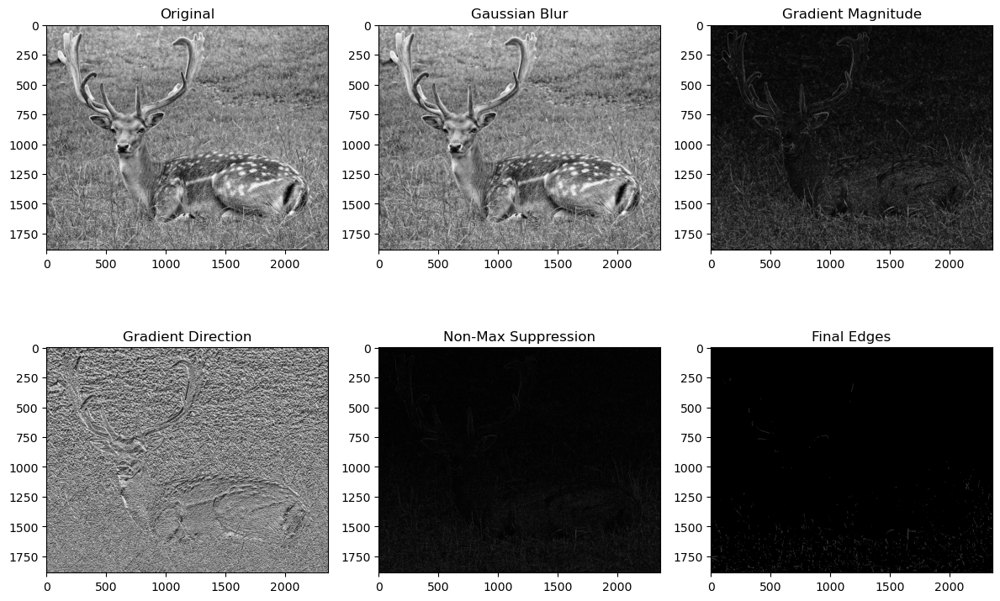

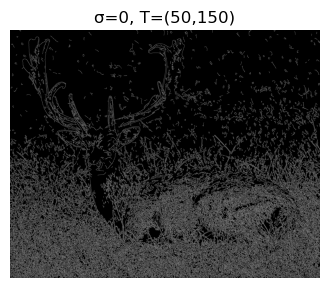

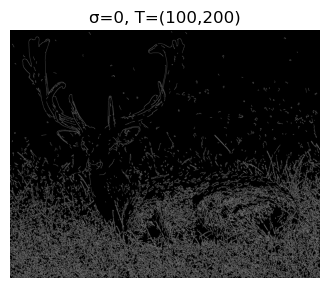

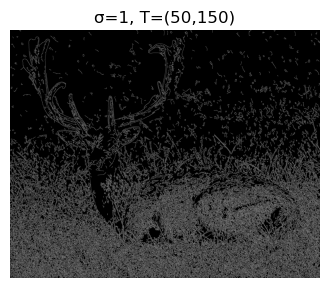

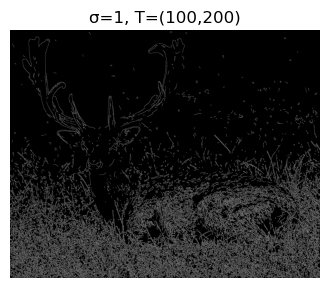

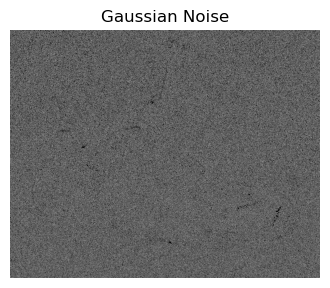

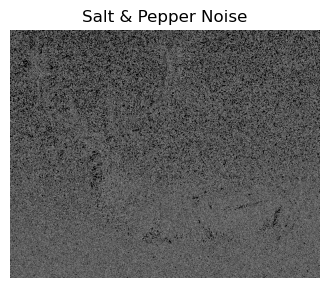

In [4]:

# ============================================
# LAB 4: CANNY EDGE DETECTOR (ONE IMAGE)
# Part A: Manual Canny Pipeline
# Part B: Edge Sensitivity Analysis
# ============================================

import cv2
import numpy as np
import matplotlib.pyplot as plt

# ============================================
# PART A: MANUAL CANNY IMPLEMENTATION
# ============================================

# Stage 1: Gaussian Blur
def gaussian_blur(image, kernel_size=5, sigma=1):
    return cv2.GaussianBlur(image, (kernel_size, kernel_size), sigma)

# Stage 2: Sobel Gradients
def sobel_gradients(image):
    Gx = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
    Gy = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)

    magnitude = np.sqrt(Gx**2 + Gy**2)
    magnitude = (magnitude / magnitude.max()) * 255
    direction = np.arctan2(Gy, Gx)

    return magnitude.astype(np.uint8), direction

# Stage 3: Non-Maximum Suppression
def non_maximum_suppression(mag, direction):
    H, W = mag.shape
    nms = np.zeros((H, W), dtype=np.uint8)

    angle = direction * 180 / np.pi
    angle[angle < 0] += 180

    for i in range(1, H-1):
        for j in range(1, W-1):
            q = r = 255

            if (0 <= angle[i,j] < 22.5) or (157.5 <= angle[i,j] <= 180):
                q = mag[i, j+1]
                r = mag[i, j-1]
            elif (22.5 <= angle[i,j] < 67.5):
                q = mag[i+1, j-1]
                r = mag[i-1, j+1]
            elif (67.5 <= angle[i,j] < 112.5):
                q = mag[i+1, j]
                r = mag[i-1, j]
            elif (112.5 <= angle[i,j] < 157.5):
                q = mag[i-1, j-1]
                r = mag[i+1, j+1]

            if mag[i,j] >= q and mag[i,j] >= r:
                nms[i,j] = mag[i,j]

    return nms

# Stage 4: Hysteresis Thresholding
def hysteresis(image, low, high):
    H, W = image.shape
    res = np.zeros((H, W), dtype=np.uint8)

    strong, weak = 255, 75

    strong_i, strong_j = np.where(image >= high)
    weak_i, weak_j = np.where((image >= low) & (image < high))

    res[strong_i, strong_j] = strong
    res[weak_i, weak_j] = weak

    for i in range(1, H-1):
        for j in range(1, W-1):
            if res[i,j] == weak:
                if np.any(res[i-1:i+2, j-1:j+2] == strong):
                    res[i,j] = strong
                else:
                    res[i,j] = 0
    return res

# Run Manual Canny
def manual_canny(image_path):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    blur = gaussian_blur(img)
    mag, direction = sobel_gradients(blur)
    nms = non_maximum_suppression(mag, direction)
    edges = hysteresis(nms, 50, 150)

    plt.figure(figsize=(12, 8))

    plt.subplot(2,3,1); plt.title("Original"); plt.imshow(img, cmap='gray')
    plt.subplot(2,3,2); plt.title("Gaussian Blur"); plt.imshow(blur, cmap='gray')
    plt.subplot(2,3,3); plt.title("Gradient Magnitude"); plt.imshow(mag, cmap='gray')
    plt.subplot(2,3,4); plt.title("Gradient Direction"); plt.imshow(direction, cmap='gray')
    plt.subplot(2,3,5); plt.title("Non-Max Suppression"); plt.imshow(nms, cmap='gray')
    plt.subplot(2,3,6); plt.title("Final Edges"); plt.imshow(edges, cmap='gray')

    plt.tight_layout()
    plt.show()

# ============================================
# PART B: EDGE SENSITIVITY ANALYSIS
# ============================================

def add_gaussian_noise(img, sigma=20):
    noise = np.random.normal(0, sigma, img.shape)
    return np.clip(img + noise, 0, 255).astype(np.uint8)

def add_salt_pepper_noise(img, amount=0.02):
    noisy = img.copy()
    h, w = img.shape
    num = int(amount * h * w)

    # Salt noise (white pixels)
    row = np.random.randint(0, h, num)
    col = np.random.randint(0, w, num)
    noisy[row, col] = 255

    # Pepper noise (black pixels)
    row = np.random.randint(0, h, num)
    col = np.random.randint(0, w, num)
    noisy[row, col] = 0

    return noisy

def canny_sensitivity(image_path):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    sigmas = [0, 1]
    thresholds = [(50,150), (100,200)]

    for sigma in sigmas:
        blur = cv2.GaussianBlur(img, (5,5), sigma)
        for low, high in thresholds:
            edges = cv2.Canny(blur, low, high)
            plt.figure(figsize=(4,4))
            plt.title(f"σ={sigma}, T=({low},{high})")
            plt.imshow(edges, cmap='gray')
            plt.axis('off')
            plt.show()

def canny_noise_test(image_path):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    g_noise = add_gaussian_noise(img)
    sp_noise = add_salt_pepper_noise(img)

    for noisy, title in [(g_noise,"Gaussian Noise"), (sp_noise,"Salt & Pepper Noise")]:
        edges = cv2.Canny(noisy, 50, 150)
        plt.figure(figsize=(4,4))
        plt.title(title)
        plt.imshow(edges, cmap='gray')
        plt.axis('off')
        plt.show()

# ============================================
# MAIN (ONE IMAGE ONLY)
# ============================================

if __name__ == "__main__":
    IMAGE_PATH = r"C:\Users\Admin\Downloads\deer.jpg"  # change to your image

    manual_canny(IMAGE_PATH)
    canny_sensitivity(IMAGE_PATH)
    canny_noise_test(IMAGE_PATH)


In [1]:
import numpy as np
import matplotlib.pyplot as plt

from tensorflow.keras.applications import VGG16
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg16 import preprocess_input

In [2]:
# Load VGG16 without fully connected layers
model = VGG16(weights='imagenet', include_top=False)

# Display model architecture
model.summary()

58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 485s 8us/step


Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, None, None, 3)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, None, None, 64)      │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, None, None, 64)      │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, None, None, 64)      │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, None, None, 128)     │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, None, None, 128)     │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, None, None, 128)     │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, None, None, 256)     │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, None, None, 256)     │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, None, None, 256)     │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, None, None, 256)     │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, None, None, 512)     │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, None, None, 512)     │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, None, None, 512)     │               0 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 14,714,688 (56.13 MB)

 Non-trainable params: 0 (0.00 B)

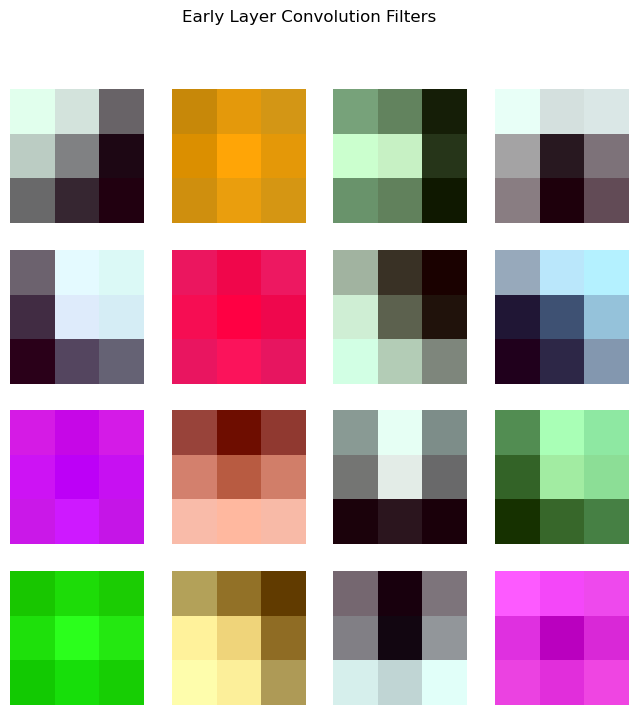

In [3]:
# Get weights of first convolution layer
filters, biases = model.layers[1].get_weights()

# Normalize filters for visualization
def normalize_filter(f):
    f_min, f_max = f.min(), f.max()
    return (f - f_min) / (f_max - f_min)

plt.figure(figsize=(8, 8))
for i in range(16):   # show first 16 filters
    f = normalize_filter(filters[:, :, :, i])
    plt.subplot(4, 4, i + 1)
    plt.imshow(f)
    plt.axis('off')

plt.suptitle("Early Layer Convolution Filters")
plt.show()


In [4]:
img_path = r"C:\Users\Admin\Downloads\deer.jpg"  # give your image path
img = image.load_img(img_path, target_size=(224, 224))

img_array = image.img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)
img_array = preprocess_input(img_array)

In [5]:
layer_names = [
    'block1_conv1',  # early layer
    'block3_conv1',  # middle layer
    'block5_conv1'   # deep layer
]

outputs = [model.get_layer(name).output for name in layer_names]

activation_model = Model(inputs=model.input, outputs=outputs)
activations = activation_model.predict(img_array)

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
